#  MARKET BASKET ANALYSIS

# Exploratory Data Analysis

In [1]:
import pandas as pd
import numpy as np
df= pd.read_csv(r"C:\Users\ACER\Documents\Mini project\market-basket-analysis-master\BreadBasket_DMS.csv")
df

,Date,Time,Transaction,Item
0,2016-10-30,09:58:11,1,Bread
1,2016-10-30,10:05:34,2,Scandinavian
2,2016-10-30,10:05:34,2,Scandinavian
3,2016-10-30,10:07:57,3,Hot chocolate
4,2016-10-30,10:07:57,3,Jam
...,...,...,...,...
21288,2017-04-09,14:32:58,9682,Coffee
21289,2017-04-09,14:32:58,9682,Tea
21290,2017-04-09,14:57:06,9683,Coffee
21291,2017-04-09,14:57:06,9683,Pastry


In [2]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21293 entries, 0 to 21292
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Date         21293 non-null  object
 1   Time         21293 non-null  object
 2   Transaction  21293 non-null  int64 
 3   Item         21293 non-null  object
dtypes: int64(1), object(3)
memory usage: 665.5+ KB


In [3]:
df.describe()

,Transaction
count,21293.000000
mean,4951.990889
std,2787.758400
min,1.000000
25%,2548.000000
50%,5067.000000
75%,7329.000000
max,9684.000000


In [4]:
df.columns

Index(['Date', 'Time', 'Transaction', 'Item'], dtype='object')

In [5]:
df.shape

(21293, 4)

In [6]:
df.isna().sum()

Date           0
Time           0
Transaction    0
Item           0
dtype: int64

In [7]:
item_counts = df['Item'].explode().value_counts()
pd.set_option('display.max_rows', None)
print(item_counts)

Coffee                           5471
Bread                            3325
Tea                              1435
Cake                             1025
Pastry                            856
NONE                              786
Sandwich                          771
Medialuna                         616
Hot chocolate                     590
Cookies                           540
Brownie                           379
Farm House                        374
Muffin                            370
Juice                             369
Alfajores                         369
Soup                              342
Scone                             327
Toast                             318
Scandinavian                      277
Truffles                          193
Coke                              185
Spanish Brunch                    172
Fudge                             159
Baguette                          152
Jam                               149
Tiffin                            146
Mineral wate

In [8]:
df

,Date,Time,Transaction,Item
0,2016-10-30,09:58:11,1,Bread
1,2016-10-30,10:05:34,2,Scandinavian
2,2016-10-30,10:05:34,2,Scandinavian
3,2016-10-30,10:07:57,3,Hot chocolate
4,2016-10-30,10:07:57,3,Jam
5,2016-10-30,10:07:57,3,Cookies
6,2016-10-30,10:08:41,4,Muffin
7,2016-10-30,10:13:03,5,Coffee
8,2016-10-30,10:13:03,5,Pastry
9,2016-10-30,10:13:03,5,Bread


In [9]:
count_of_NONE = df['Item'].value_counts()['NONE']
print("Count of 'NONE':", count_of_NONE)


Count of 'NONE': 786


In [10]:
modes = df['Item'].mode()
print(modes)

0    Coffee
Name: Item, dtype: object


In [11]:
df['Item'] = df['Item'].replace('NONE','Coffee')

In [12]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
df['new_item']= encoder.fit_transform(df['Item'])

In [13]:
# Assuming "Date" column contains datetime information
df['Date'] = pd.to_datetime(df['Date'])  # Convert "Date" column to datetime if not already

# Set "Date" column as the index
df.set_index('Date', inplace=True)



C:\Users\ACER\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


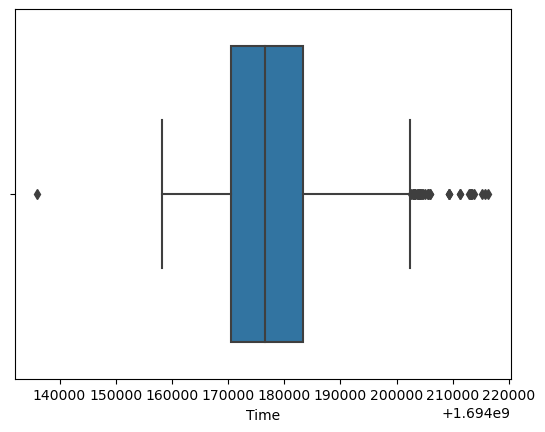

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
df['Time'] = pd.to_datetime(df['Time'])

# Convert datetime objects to Unix timestamps (seconds since the epoch)
df['Time'] = df['Time'].astype('int64') // 10**9

# Create a box plot with 'Unix_Time' on the x-axis and no y-axis specified
sns.boxplot(df['Time'])


plt.show()

In [15]:
df

,Time,Transaction,Item,new_item
Date,,,,
2016-10-30,1694167091,1,Bread,11
2016-10-30,1694167534,2,Scandinavian,74
2016-10-30,1694167534,2,Scandinavian,74
2016-10-30,1694167677,3,Hot chocolate,48
2016-10-30,1694167677,3,Jam,49
2016-10-30,1694167677,3,Cookies,26
2016-10-30,1694167721,4,Muffin,60
2016-10-30,1694167983,5,Coffee,23
2016-10-30,1694167983,5,Pastry,65


C:\Users\ACER\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


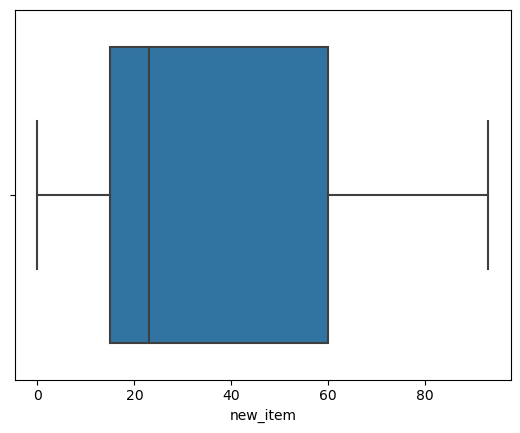

In [16]:
import matplotlib.pyplot as plt
sns.boxplot(df['new_item'])
plt.show()

C:\Users\ACER\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


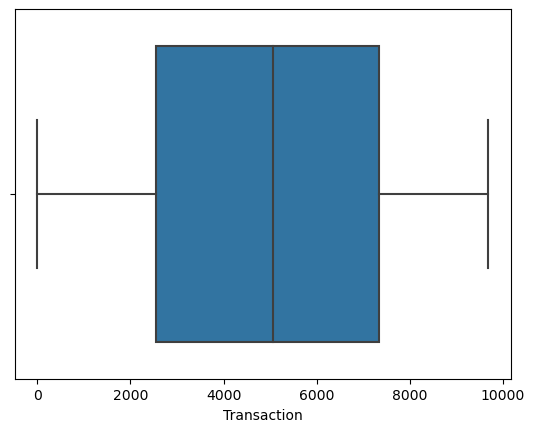

In [17]:
sns.boxplot(df['Transaction'])
plt.show()

In [18]:
Q1 = df['Time'].quantile(0.25)
Q3 = df['Time'].quantile(0.75)

# Calculate the Interquartile Range (IQR)
IQR = Q3 - Q1

# Define a multiplier to determine the IQR range for outliers (e.g., 1.5)
IQR_multiplier = 1.5

# Identify potential outliers based on the IQR method
potential_outliers = df[(df['Time'] < Q1 - IQR_multiplier * IQR) | (df['Time'] > Q3 + IQR_multiplier * IQR)]

print(potential_outliers)







                  Time  Transaction              Item  new_item
Date                                                           
2016-11-04  1694203247          523    Dulce de Leche        31
2016-11-04  1694203247          523             Fudge        40
2016-11-09  1694202562          938        Adjustment         0
2016-12-15  1694203861         3223    Vegan mincepie        92
2016-12-17  1694204447         3383           Pintxos        67
2016-12-17  1694204721         3384           Pintxos        67
2016-12-17  1694205098         3385           Pintxos        67
2016-12-17  1694205607         3386              Coke        25
2016-12-17  1694205607         3386           Pintxos        67
2016-12-17  1694209333         3387     Hot chocolate        48
2016-12-17  1694209333         3387     Hot chocolate        48
2017-01-01  1694136065         4090             Bread        11
2017-01-27  1694204402         5459            Coffee        23
2017-02-04  1694202984         6018  Val

In [19]:
Q1 = df['Time'].quantile(0.25)
Q3 = df['Time'].quantile(0.75)
    
IQR=Q3-Q1
low=Q1-1.5*IQR
up=Q3+1.5*IQR
    
for j in df['Time']:
    if j<low:
        df['Time']=df['Time'].replace(j,low)
    elif j>up:
        df['Time']=df["Time"].replace(j,up)

C:\Users\ACER\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


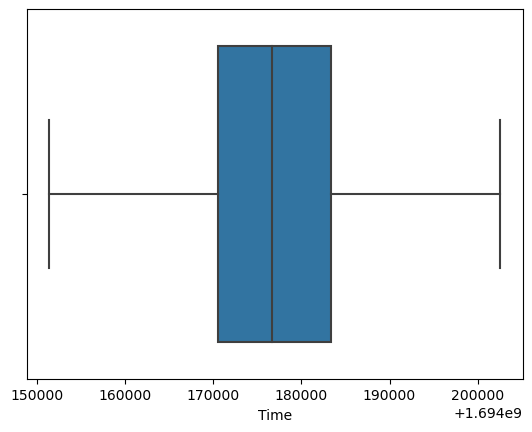

In [20]:
sns.boxplot(df['Time'])

plt.show()

In [22]:
total_items = len(df)
total_days = len(np.unique(df.index.date))
total_months = len(np.unique(df.index.month))
average_items = total_items / total_days
unique_items = df.Item.unique().size

print("There are {} unique items sold by the Bakery".format(unique_items))
print("Total {} items sold in {} days throughout {} months".format(total_items, total_days, total_months))
print("With an average of {} items sold daily".format(average_items))

There are 94 unique items sold by the Bakery
Total 21293 items sold in 159 days throughout 7 months
With an average of 133.9182389937107 items sold daily


In [23]:
# rank the top 10 best-selling items
df.Item.value_counts(normalize=True)[:10]

Coffee           0.293852
Bread            0.156155
Tea              0.067393
Cake             0.048138
Pastry           0.040201
Sandwich         0.036209
Medialuna        0.028930
Hot chocolate    0.027709
Cookies          0.025360
Brownie          0.017799
Name: Item, dtype: float64

# Data Visualisation

[Text(0.5, 0, 'Item'), Text(0, 0.5, 'Percentage')]

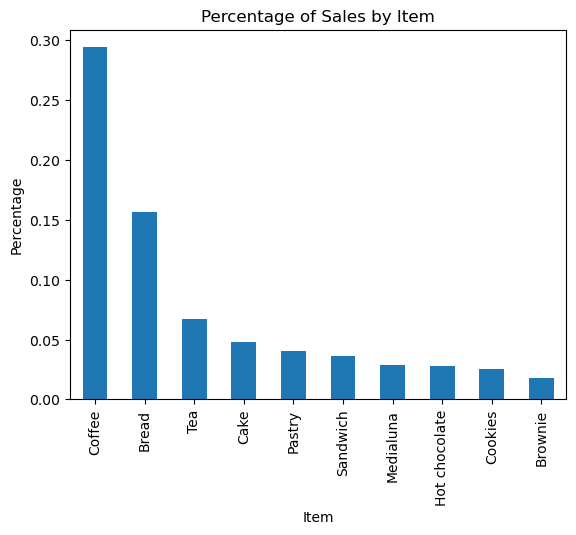

In [24]:
# create a bar chart, rank by percentage
df.Item.value_counts(normalize=True)[:10].plot(kind="bar", title="Percentage of Sales by Item").set(xlabel="Item", ylabel="Percentage")


[Text(0.5, 0, 'Item'), Text(0, 0.5, 'Total Number')]

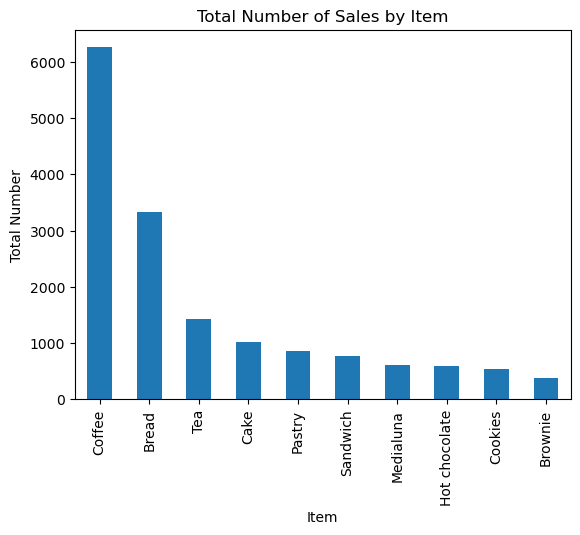

In [25]:
# create a bar chart, rank by value
df.Item.value_counts()[:10].plot(kind="bar", title="Total Number of Sales by Item").set(xlabel="Item", ylabel="Total Number")

The bar charts clearly indicate that Coffee is the top-selling item in the bakery, accounting for 26.7% of total sales, followed by Bread at 16.2%, and Tea at 7.0%.

[Text(0.5, 0, 'Date'), Text(0, 0.5, 'Total Number of Items Sold')]

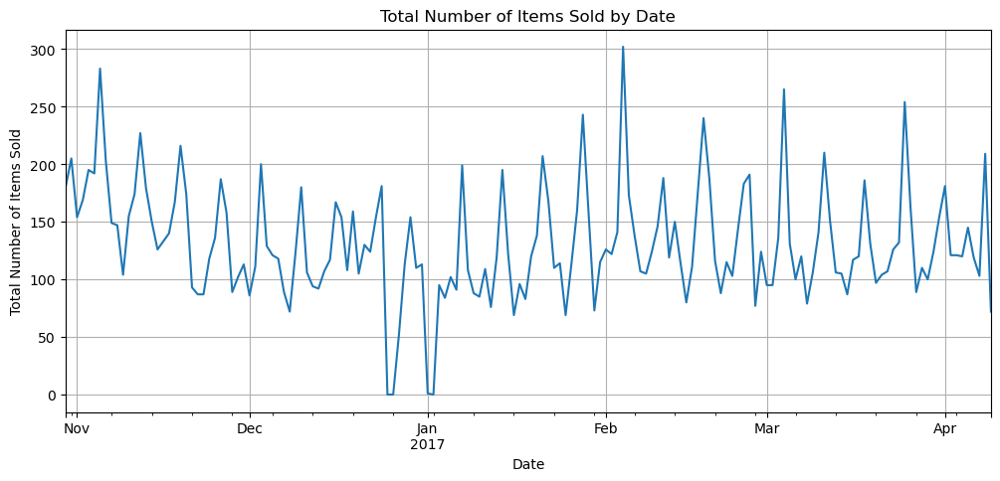

In [26]:
# Now, you can use .resample() on the DataFrame
df["Item"].resample("D").count().plot(figsize=(12,5), grid=True, title="Total Number of Items Sold by Date").set(xlabel="Date", ylabel="Total Number of Items Sold")


The quantity of items sold on each date shows significant fluctuations over the course of the 159-day data period.

In [27]:
df["Item"].resample("M").count()

Date
2016-10-31     385
2016-11-30    4607
2016-12-31    3569
2017-01-31    3509
2017-02-28    3991
2017-03-31    4041
2017-04-30    1191
Freq: M, Name: Item, dtype: int64

[Text(0.5, 0, 'Date'), Text(0, 0.5, 'Total Number of Items Sold')]

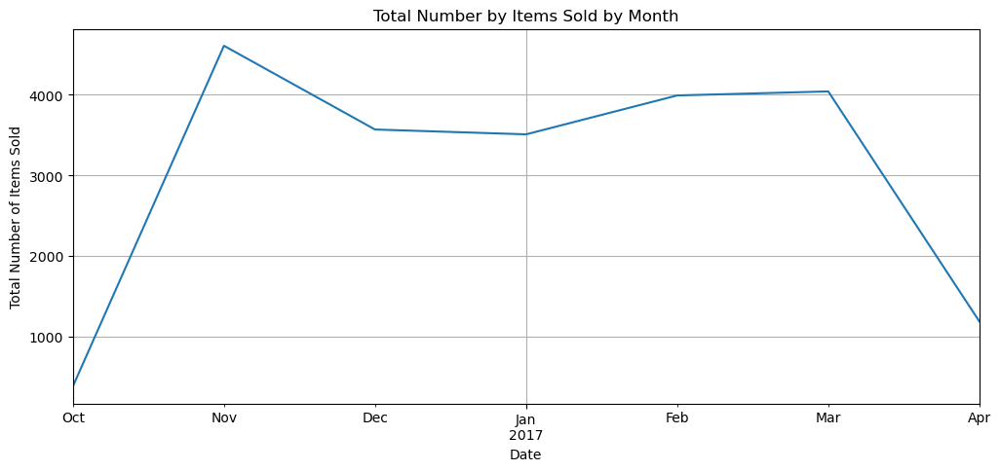

In [28]:
# plot time series chart of number of items by month
df["Item"].resample("M").count().plot(figsize=(12,5), grid=True, title="Total Number by Items Sold by Month").set(xlabel="Date", ylabel="Total Number of Items Sold")


Considering that the initial month (October 2016) and concluding month (April 2017) are incomplete, the total number of items sold during the five complete months spanning from November 2016 to March 2017 demonstrates relatively stable patterns with less pronounced fluctuations.

In [29]:

df['Time'] = pd.to_datetime(df['Time'], unit='s')  # Convert 'Time' to datetime
df['Hour'] = df['Time'].dt.hour  # Extract hour component


In [30]:
bread_groupby_hour = df.groupby("Hour").agg({"Item": lambda item: item.count()/total_days})
bread_groupby_hour

,Item
Hour,
5,0.006289
7,0.157233
8,4.207547
9,12.861635
10,17.377358
11,20.226415
12,19.000000
13,17.459119
14,17.207547


[Text(0.5, 0, 'Hour of the Day (24 hour time)'),
 Text(0, 0.5, 'Average Number of Items Sold')]

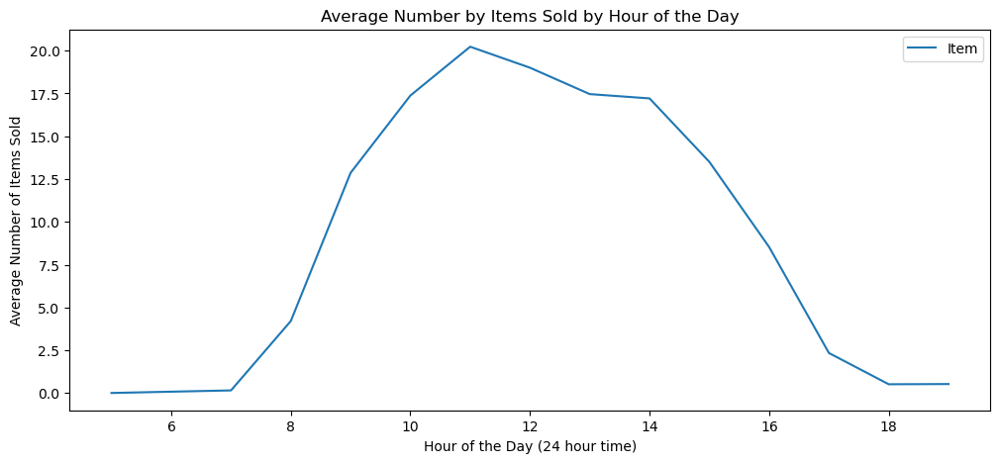

In [31]:
# plot the chart
bread_groupby_hour.plot(y="Item", figsize=(12,5), title="Average Number by Items Sold by Hour of the Day").set(xlabel="Hour of the Day (24 hour time)", ylabel="Average Number of Items Sold")


Sales gradually increase starting by 8 am and peak during the busiest hour at 11 am, after which they gradually decline through the late afternoon. Notably, a significant portion of the sales transactions occurs during the lunch hours of the day.

In [32]:
transactions=[]
for i in range (len(df['Item'])):
    transactions.append(df['Item'][i])
transactions = np.array(transactions)
print(transactions)

['Bread' 'Scandinavian' 'Scandinavian' ... 'Coffee' 'Pastry' 'Smoothies']


In [33]:
# Creating the frequency table
frequency_table = df['Item'].value_counts()

# Printing the frequency table
print(frequency_table)

Coffee                           6257
Bread                            3325
Tea                              1435
Cake                             1025
Pastry                            856
Sandwich                          771
Medialuna                         616
Hot chocolate                     590
Cookies                           540
Brownie                           379
Farm House                        374
Muffin                            370
Alfajores                         369
Juice                             369
Soup                              342
Scone                             327
Toast                             318
Scandinavian                      277
Truffles                          193
Coke                              185
Spanish Brunch                    172
Fudge                             159
Baguette                          152
Jam                               149
Tiffin                            146
Mineral water                     136
Jammie Dodge

In [34]:
# Scanning the database the second time and arranging elements based on the frequency table
arranged_data = df['Item'].map(frequency_table).sort_values(ascending=False)

# Printing the arranged data
print(arranged_data)

Date
2016-12-29    6257
2017-01-13    6257
2016-11-26    6257
2017-02-14    6257
2017-02-14    6257
2016-11-26    6257
2017-01-13    6257
2016-11-26    6257
2016-12-19    6257
2017-02-14    6257
2016-12-19    6257
2016-12-19    6257
2017-02-14    6257
2017-02-14    6257
2017-02-14    6257
2017-02-15    6257
2017-02-15    6257
2017-01-13    6257
2017-02-15    6257
2017-02-15    6257
2016-12-19    6257
2017-02-15    6257
2017-02-15    6257
2016-11-25    6257
2017-02-14    6257
2017-01-13    6257
2016-12-19    6257
2017-01-13    6257
2017-02-14    6257
2016-11-26    6257
2017-02-14    6257
2017-02-14    6257
2016-11-26    6257
2017-02-14    6257
2017-02-14    6257
2017-02-14    6257
2017-02-14    6257
2016-11-26    6257
2017-02-14    6257
2017-02-14    6257
2017-01-13    6257
2016-11-26    6257
2016-11-26    6257
2016-11-26    6257
2017-02-14    6257
2017-01-13    6257
2017-02-14    6257
2017-02-14    6257
2016-11-26    6257
2017-02-15    6257
2017-01-13    6257
2016-11-25    6257
2017-02

In [35]:
grouped_data = df.groupby('Transaction')['Item'].apply(list)

# Printing the grouped data
print(grouped_data)

Transaction
1                                                 [Bread]
2                            [Scandinavian, Scandinavian]
3                           [Hot chocolate, Jam, Cookies]
4                                                [Muffin]
5                                 [Coffee, Pastry, Bread]
6                             [Medialuna, Pastry, Muffin]
7                        [Medialuna, Pastry, Coffee, Tea]
8                                         [Pastry, Bread]
9                                         [Bread, Muffin]
10                              [Scandinavian, Medialuna]
11                      [Bread, Medialuna, Bread, Coffee]
12                    [Jam, Coffee, Tartine, Pastry, Tea]
13                                [Basket, Bread, Coffee]
14                             [Bread, Medialuna, Pastry]
15          [Coffee, Coffee, Mineral water, Scandinavian]
16                             [Bread, Medialuna, Coffee]
17                                        [Hot chocolate]
18

In [36]:
# Converting the grouped data into a table
df = pd.DataFrame(grouped_data.reset_index())
df

,Transaction,Item
0,1,[Bread]
1,2,"[Scandinavian, Scandinavian]"
2,3,"[Hot chocolate, Jam, Cookies]"
3,4,[Muffin]
4,5,"[Coffee, Pastry, Bread]"
5,6,"[Medialuna, Pastry, Muffin]"
6,7,"[Medialuna, Pastry, Coffee, Tea]"
7,8,"[Pastry, Bread]"
8,9,"[Bread, Muffin]"
9,10,"[Scandinavian, Medialuna]"


# F P Tree Algorithm

In [37]:
transactions=[]
for i in range (len(df['Item'])):
    transactions.append(df['Item'][i])

print(transactions)

[['Bread'], ['Scandinavian', 'Scandinavian'], ['Hot chocolate', 'Jam', 'Cookies'], ['Muffin'], ['Coffee', 'Pastry', 'Bread'], ['Medialuna', 'Pastry', 'Muffin'], ['Medialuna', 'Pastry', 'Coffee', 'Tea'], ['Pastry', 'Bread'], ['Bread', 'Muffin'], ['Scandinavian', 'Medialuna'], ['Bread', 'Medialuna', 'Bread', 'Coffee'], ['Jam', 'Coffee', 'Tartine', 'Pastry', 'Tea'], ['Basket', 'Bread', 'Coffee'], ['Bread', 'Medialuna', 'Pastry'], ['Coffee', 'Coffee', 'Mineral water', 'Scandinavian'], ['Bread', 'Medialuna', 'Coffee'], ['Hot chocolate'], ['Farm House'], ['Farm House', 'Bread'], ['Bread', 'Medialuna'], ['Coffee', 'Coffee', 'Medialuna', 'Bread'], ['Jam'], ['Scandinavian', 'Muffin'], ['Bread'], ['Scandinavian'], ['Fudge'], ['Scandinavian'], ['Coffee', 'Bread'], ['Bread', 'Jam', 'Coffee'], ['Bread'], ['Basket'], ['Scandinavian', 'Muffin'], ['Coffee'], ['Coffee', 'Muffin'], ['Muffin', 'Scandinavian'], ['Tea', 'Bread'], ['Coffee', 'Bread', 'Coffee'], ['Bread', 'Tea'], ['Scandinavian'], ['Juice', 

In [38]:

from mlxtend.preprocessing import TransactionEncoder

# instantiate a transaction encoder
my_transactionencoder = TransactionEncoder()

In [39]:
# fit the transaction encoder using the list of transaction tuples
my_transactionencoder.fit(transactions)

TransactionEncoder()

In [40]:
# transform the list of transaction tuples into an array of encoded transactions
encoded_transactions = my_transactionencoder.transform(transactions)

In [41]:
# convert the array of encoded transactions into a dataframe
encoded_transactions_df = pd.DataFrame(encoded_transactions, columns=my_transactionencoder.columns_)
encoded_transactions_df

,Adjustment,Afternoon with the baker,Alfajores,Argentina Night,Art Tray,Bacon,Baguette,Bakewell,Bare Popcorn,Basket,...,The BART,The Nomad,Tiffin,Toast,Truffles,Tshirt,Valentine's card,Vegan Feast,Vegan mincepie,Victorian Sponge
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
7,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
9,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [42]:
# our min support is 5, but it has to be expressed as a percentage for mlxtend
min_support = 5/len(transactions) 

In [43]:
# compute the frequent itemsets using fpgriowth from mlxtend
from mlxtend.frequent_patterns.fpgrowth import fpgrowth
frequent_itemsets = fpgrowth(encoded_transactions_df, min_support=min_support, use_colnames = True)

In [44]:
# print the frequent itemsets
frequent_itemsets

,support,itemsets
0,0.324940,(Bread)
1,0.028853,(Scandinavian)
2,0.057916,(Hot chocolate)
3,0.054034,(Cookies)
4,0.014899,(Jam)
5,0.038191,(Muffin)
6,0.512013,(Coffee)
7,0.085510,(Pastry)
8,0.061379,(Medialuna)
9,0.141643,(Tea)


In [48]:
# Compute the association rules based on the frequent itemsets
from mlxtend.frequent_patterns import association_rules

# compute and print the association rules
association_rules(frequent_itemsets, metric="confidence", min_threshold=0.9)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,"(Bread, Sandwich, Medialuna)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
1,"(Hearty & Seasonal, Cake)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
2,"(Toast, Farm House)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
3,(Extra Salami or Feta),(Coffee),0.003987,0.512013,0.003672,0.921053,1.798884,0.001631,6.181163,0.445877
4,"(Extra Salami or Feta, Cake)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
5,"(Extra Salami or Feta, Sandwich)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
6,"(Extra Salami or Feta, Toast)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
7,"(Extra Salami or Feta, Spanish Brunch)",(Coffee),0.000839,0.512013,0.000839,1.000000,1.953074,0.000410,inf,0.488397
8,(Duck egg),(Coffee),0.001259,0.512013,0.001154,0.916667,1.790318,0.000509,5.855839,0.441996


In [46]:
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)
rules.sort_values("confidence", ascending = False, inplace = True)
rules.head(10)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
2388,"(Extra Salami or Feta, Spanish Brunch)",(Coffee),0.000839,0.512013,0.000839,1.000000,1.953074,0.000410,inf,0.488397
2371,"(Extra Salami or Feta, Sandwich)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
2382,"(Extra Salami or Feta, Toast)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
2365,"(Extra Salami or Feta, Cake)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
1954,"(Toast, Farm House)",(Coffee),0.000630,0.512013,0.000630,1.000000,1.953074,0.000307,inf,0.488294
873,"(Hearty & Seasonal, Cake)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
553,"(Bread, Sandwich, Medialuna)",(Coffee),0.000734,0.512013,0.000734,1.000000,1.953074,0.000358,inf,0.488345
2340,(Extra Salami or Feta),(Coffee),0.003987,0.512013,0.003672,0.921053,1.798884,0.001631,6.181163,0.445877
2394,(Duck egg),(Coffee),0.001259,0.512013,0.001154,0.916667,1.790318,0.000509,5.855839,0.441996
2328,"(Spanish Brunch, Toast)",(Coffee),0.001049,0.512013,0.000944,0.900000,1.757766,0.000407,4.879866,0.431549
